In [1]:
import pandas as pd
import datetime
import calendar
import folium
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
data=pd.read_csv("train.csv")[:10000]

In [3]:
data.head()

,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE
0,1372636858620000589,C,NaN,NaN,20000589,1372636858,A,False,"[[-8.618643,41.141412],[-8.618499,41.141376],[..."
1,1372637303620000596,B,NaN,7.0,20000596,1372637303,A,False,"[[-8.639847,41.159826],[-8.640351,41.159871],[..."
2,1372636951620000320,C,NaN,NaN,20000320,1372636951,A,False,"[[-8.612964,41.140359],[-8.613378,41.14035],[-..."
3,1372636854620000520,C,NaN,NaN,20000520,1372636854,A,False,"[[-8.574678,41.151951],[-8.574705,41.151942],[..."
4,1372637091620000337,C,NaN,NaN,20000337,1372637091,A,False,"[[-8.645994,41.18049],[-8.645949,41.180517],[-..."


### Data Processing

In [4]:
df=data[['TRIP_ID','CALL_TYPE','TIMESTAMP','POLYLINE']]

In [5]:
df.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,POLYLINE
0,1372636858620000589,C,1372636858,"[[-8.618643,41.141412],[-8.618499,41.141376],[..."
1,1372637303620000596,B,1372637303,"[[-8.639847,41.159826],[-8.640351,41.159871],[..."
2,1372636951620000320,C,1372636951,"[[-8.612964,41.140359],[-8.613378,41.14035],[-..."
3,1372636854620000520,C,1372636854,"[[-8.574678,41.151951],[-8.574705,41.151942],[..."
4,1372637091620000337,C,1372637091,"[[-8.645994,41.18049],[-8.645949,41.180517],[-..."


In [6]:
df.POLYLINE.iloc[0][0]

'['

In [7]:
df.POLYLINE = df.POLYLINE.apply(eval)

C:\Users\chinm\AppData\Local\Temp\ipykernel_17264\4177019266.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.POLYLINE = df.POLYLINE.apply(eval)


In [8]:
df.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,POLYLINE
0,1372636858620000589,C,1372636858,"[[-8.618643, 41.141412], [-8.618499, 41.141376..."
1,1372637303620000596,B,1372637303,"[[-8.639847, 41.159826], [-8.640351, 41.159871..."
2,1372636951620000320,C,1372636951,"[[-8.612964, 41.140359], [-8.613378, 41.14035]..."
3,1372636854620000520,C,1372636854,"[[-8.574678, 41.151951], [-8.574705, 41.151942..."
4,1372637091620000337,C,1372637091,"[[-8.645994, 41.18049], [-8.645949, 41.180517]..."


In [9]:
df.POLYLINE.iloc[0][0]

[-8.618643, 41.141412]

In [10]:
df['POLYLINE']

0       [[-8.618643, 41.141412], [-8.618499, 41.141376...
1       [[-8.639847, 41.159826], [-8.640351, 41.159871...
2       [[-8.612964, 41.140359], [-8.613378, 41.14035]...
3       [[-8.574678, 41.151951], [-8.574705, 41.151942...
4       [[-8.645994, 41.18049], [-8.645949, 41.180517]...
                              ...                        
9995    [[-8.66808, 41.154651], [-8.668089, 41.154651]...
9996    [[-8.583129, 41.164731], [-8.583129, 41.164785...
9997    [[-8.600103, 41.18274], [-8.599806, 41.182722]...
9998    [[-8.5878, 41.174568], [-8.587782, 41.174595],...
9999    [[-8.613144, 41.166774], [-8.613333, 41.166675...
Name: POLYLINE, Length: 10000, dtype: object

In [11]:
extract_starting_point = lambda list_ : list_[0] if list_ else None
extract_ending_point = lambda list_ : list_[-1] if list_ else None
df["START_LOC"] = df.POLYLINE.apply(extract_starting_point)
df["END_LOC"] = df.POLYLINE.apply(extract_ending_point)

C:\Users\chinm\AppData\Local\Temp\ipykernel_17264\2471489188.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["START_LOC"] = df.POLYLINE.apply(extract_starting_point)
C:\Users\chinm\AppData\Local\Temp\ipykernel_17264\2471489188.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["END_LOC"] = df.POLYLINE.apply(extract_ending_point)


In [12]:
df.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,POLYLINE,START_LOC,END_LOC
0,1372636858620000589,C,1372636858,"[[-8.618643, 41.141412], [-8.618499, 41.141376...","[-8.618643, 41.141412]","[-8.630838, 41.154489]"
1,1372637303620000596,B,1372637303,"[[-8.639847, 41.159826], [-8.640351, 41.159871...","[-8.639847, 41.159826]","[-8.66574, 41.170671]"
2,1372636951620000320,C,1372636951,"[[-8.612964, 41.140359], [-8.613378, 41.14035]...","[-8.612964, 41.140359]","[-8.61597, 41.14053]"
3,1372636854620000520,C,1372636854,"[[-8.574678, 41.151951], [-8.574705, 41.151942...","[-8.574678, 41.151951]","[-8.607996, 41.142915]"
4,1372637091620000337,C,1372637091,"[[-8.645994, 41.18049], [-8.645949, 41.180517]...","[-8.645994, 41.18049]","[-8.687268, 41.178087]"


In [13]:
df['START_LOC'] = df['START_LOC'].apply(lambda x: [x[1], x[0]] if x is not None else x)
df['END_LOC'] = df['END_LOC'].apply(lambda x: [x[1], x[0]] if x is not None else x)

C:\Users\chinm\AppData\Local\Temp\ipykernel_17264\1732992012.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['START_LOC'] = df['START_LOC'].apply(lambda x: [x[1], x[0]] if x is not None else x)
C:\Users\chinm\AppData\Local\Temp\ipykernel_17264\1732992012.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['END_LOC'] = df['END_LOC'].apply(lambda x: [x[1], x[0]] if x is not None else x)


In [14]:
def reverse_coordinates(polyline):
    return [[coord[1], coord[0]] for coord in polyline]

# Apply the function to the POLYLINE column
df['POLYLINE'] = df['POLYLINE'].apply(reverse_coordinates)

# Display the DataFrame to verify the changes
df.head()

C:\Users\chinm\AppData\Local\Temp\ipykernel_17264\2146438518.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['POLYLINE'] = df['POLYLINE'].apply(reverse_coordinates)


,TRIP_ID,CALL_TYPE,TIMESTAMP,POLYLINE,START_LOC,END_LOC
0,1372636858620000589,C,1372636858,"[[41.141412, -8.618643], [41.141376, -8.618499...","[41.141412, -8.618643]","[41.154489, -8.630838]"
1,1372637303620000596,B,1372637303,"[[41.159826, -8.639847], [41.159871, -8.640351...","[41.159826, -8.639847]","[41.170671, -8.66574]"
2,1372636951620000320,C,1372636951,"[[41.140359, -8.612964], [41.14035, -8.613378]...","[41.140359, -8.612964]","[41.14053, -8.61597]"
3,1372636854620000520,C,1372636854,"[[41.151951, -8.574678], [41.151942, -8.574705...","[41.151951, -8.574678]","[41.142915, -8.607996]"
4,1372637091620000337,C,1372637091,"[[41.18049, -8.645994], [41.180517, -8.645949]...","[41.18049, -8.645994]","[41.178087, -8.687268]"


In [15]:
df.sample(10)

,TRIP_ID,CALL_TYPE,TIMESTAMP,POLYLINE,START_LOC,END_LOC
3708,1372688471620000067,B,1372688471,"[[41.172039, -8.611191], [41.171175, -8.611317...","[41.172039, -8.611191]","[41.158017, -8.63676]"
7818,1372781784620000036,B,1372781784,"[[41.148081, -8.619849], [41.148081, -8.619849...","[41.148081, -8.619849]","[41.167161, -8.599356]"
3064,1372688695620000216,A,1372688695,"[[41.176332, -8.623953], [41.176341, -8.623935...","[41.176332, -8.623953]","[41.14665, -8.61984]"
4336,1372721746620000688,B,1372721746,"[[41.15943, -8.580096], [41.159322, -8.581617]...","[41.15943, -8.580096]","[41.193846, -8.57412]"
6184,1372762696620000146,B,1372762696,"[[41.163066, -8.584344], [41.162913, -8.584776...","[41.163066, -8.584344]","[41.163219, -8.59032]"
1156,1372665024620000167,B,1372665024,"[[41.148018, -8.619849], [41.147568, -8.620272...","[41.148018, -8.619849]","[41.160897, -8.65548]"
0,1372636858620000589,C,1372636858,"[[41.141412, -8.618643], [41.141376, -8.618499...","[41.141412, -8.618643]","[41.154489, -8.630838]"
1357,1372672758620000669,A,1372672758,"[[41.150367, -8.583669], [41.150385, -8.583525...","[41.150367, -8.583669]","[41.161329, -8.657082]"
8702,1372799353620000496,B,1372799353,"[[41.144616, -8.606448], [41.144832, -8.606988...","[41.144616, -8.606448]","[41.117616, -8.60805]"
5562,1372742693620000235,B,1372742693,"[[41.144661, -8.606439], [41.144715, -8.606619...","[41.144661, -8.606439]","[41.148846, -8.585838]"


In [16]:
CALL_TYPES = {
    "A":"CENTRAL_BASED",
    "B":"STAND_BASED",
    "C":"OTHER",
}

df.CALL_TYPE = df.CALL_TYPE.map(CALL_TYPES)

C:\Users\chinm\AppData\Local\Temp\ipykernel_17264\3082480146.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.CALL_TYPE = df.CALL_TYPE.map(CALL_TYPES)


In [17]:
print(df['START_LOC'])

0       [41.141412, -8.618643]
1       [41.159826, -8.639847]
2       [41.140359, -8.612964]
3       [41.151951, -8.574678]
4        [41.18049, -8.645994]
                 ...          
9995     [41.154651, -8.66808]
9996    [41.164731, -8.583129]
9997     [41.18274, -8.600103]
9998      [41.174568, -8.5878]
9999    [41.166774, -8.613144]
Name: START_LOC, Length: 10000, dtype: object


In [18]:
q1_df = df.CALL_TYPE.value_counts(sort=False)

In [19]:
q1_df

CALL_TYPE
OTHER            2514
STAND_BASED      5157
CENTRAL_BASED    2329
Name: count, dtype: int64

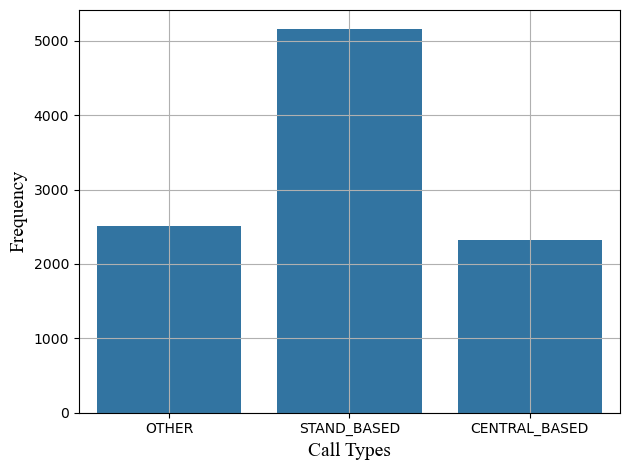

In [20]:
fig, ax = plt.subplots(tight_layout=True)
sns.barplot(data=q1_df)
ax.set_xlabel("Call Types", font="Times New Roman", fontsize='14')
ax.set_ylabel("Frequency", font="Times New Roman", fontsize='14')
plt.grid()
plt.show()

In [21]:
#Most Common Taxi Points
map = folium.Map(location= [41.141412, -8.618643], zoom_start=13)
for point in df.START_LOC:
    if point is not None and len(df['START_LOC']) == 10000:
        folium.CircleMarker(location=point, color="red", radius=1, weight=2).add_to(map)
map

In [22]:
colors = {
    "OTHER":"green",
    "STAND_BASED":"orange",
    "CENTRAL_BASED":"yellow"
}

In [23]:
m_2 = df[["CALL_TYPE","START_LOC"]]  

In [24]:
m_2.head()

,CALL_TYPE,START_LOC
0,OTHER,"[41.141412, -8.618643]"
1,STAND_BASED,"[41.159826, -8.639847]"
2,OTHER,"[41.140359, -8.612964]"
3,OTHER,"[41.151951, -8.574678]"
4,OTHER,"[41.18049, -8.645994]"


In [25]:
#Pick up points based on call type
map_2 = folium.Map(location= [41.141412, -8.618643], zoom_start=13)
for index, row in m_2.iterrows():
    if row["START_LOC"] is not None and len(df['START_LOC']) == 10000:
        color = colors[row['CALL_TYPE']]
        location = row["START_LOC"]
        folium.CircleMarker(location, color=color, radius=1, weight=2).add_to(map_2)

In [26]:
map_2

In [27]:
df.TIMESTAMP.iloc[0]

1372636858

In [28]:
day_names=list(calendar.day_name)

In [29]:
get_day = lambda timestamp : day_names[datetime.datetime.fromtimestamp(timestamp).weekday()]
df['WEEK_DAY']=df.TIMESTAMP.apply(get_day)

C:\Users\chinm\AppData\Local\Temp\ipykernel_17264\623885488.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WEEK_DAY']=df.TIMESTAMP.apply(get_day)


In [30]:
w_map = folium.Map(location= [41.141412, -8.618643], zoom_start=13)

In [31]:
weekdays_colors = {
    "Monday": "Red",
    "Tuesday": "Orange",
    "Wednesday": "Yellow",
    "Thursday": "Green",
    "Friday": "Blue",
    "Saturday": "Indigo",
    "Sunday": "Violet"
}

In [32]:
m_3 = df[["WEEK_DAY","END_LOC"]]  

In [33]:
#Trips based on Days
w_map = folium.Map(location= [41.141412, -8.618643], zoom_start=13)
for index, row in m_3.iterrows():
    if row["END_LOC"] is not None and len(df['END_LOC']) == 10000:
        color = weekdays_colors[row['WEEK_DAY']]
        location = row["END_LOC"]
        folium.CircleMarker(location, color=color, radius=1, weight=2).add_to(w_map)

In [34]:
w_map

In [35]:
hour = lambda timestamp : datetime.datetime.fromtimestamp(timestamp).hour

In [36]:
df['HOUR']=df.TIMESTAMP.apply(hour)

C:\Users\chinm\AppData\Local\Temp\ipykernel_17264\1004790765.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['HOUR']=df.TIMESTAMP.apply(hour)


In [37]:
df.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,POLYLINE,START_LOC,END_LOC,WEEK_DAY,HOUR
0,1372636858620000589,OTHER,1372636858,"[[41.141412, -8.618643], [41.141376, -8.618499...","[41.141412, -8.618643]","[41.154489, -8.630838]",Monday,5
1,1372637303620000596,STAND_BASED,1372637303,"[[41.159826, -8.639847], [41.159871, -8.640351...","[41.159826, -8.639847]","[41.170671, -8.66574]",Monday,5
2,1372636951620000320,OTHER,1372636951,"[[41.140359, -8.612964], [41.14035, -8.613378]...","[41.140359, -8.612964]","[41.14053, -8.61597]",Monday,5
3,1372636854620000520,OTHER,1372636854,"[[41.151951, -8.574678], [41.151942, -8.574705...","[41.151951, -8.574678]","[41.142915, -8.607996]",Monday,5
4,1372637091620000337,OTHER,1372637091,"[[41.18049, -8.645994], [41.180517, -8.645949]...","[41.18049, -8.645994]","[41.178087, -8.687268]",Monday,5


In [38]:
h_df=df[(df.WEEK_DAY=='Monday') & (df.HOUR>6) & (df.HOUR<9)]

In [39]:
h_df.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,POLYLINE,START_LOC,END_LOC,WEEK_DAY,HOUR
54,1372642886620000403,STAND_BASED,1372642886,"[[41.145786, -8.610912]]","[41.145786, -8.610912]","[41.145786, -8.610912]",Monday,7
58,1372642706620000653,STAND_BASED,1372642706,"[[41.157378, -8.628327], [41.157801, -8.627994...","[41.157378, -8.628327]","[41.164209, -8.623071]",Monday,7
65,1372643618620000463,STAND_BASED,1372643618,"[[41.140764, -8.615394], [41.14143, -8.614467]...","[41.140764, -8.615394]","[41.147019, -8.620146]",Monday,7
71,1372643656620000492,OTHER,1372643656,"[[41.161221, -8.605017], [41.160807, -8.605188...","[41.161221, -8.605017]","[41.153346, -8.651862]",Monday,7
75,1372644235620000520,OTHER,1372644235,"[[41.150385, -8.611569], [41.150331, -8.61201]...","[41.150385, -8.611569]","[41.147325, -8.602524]",Monday,7


In [40]:
h_map=folium.Map(location= [41.141412, -8.618643], zoom_start=13)

In [41]:
start_loc = lambda loc:folium.CircleMarker(loc, color='green', radius=1,weight=2).add_to(h_map)
end_loc = lambda loc:folium.CircleMarker(loc, color='red', radius=1,weight=2).add_to(h_map)

In [42]:
#Start and End Points between 6 and 9 am
h_df.START_LOC.apply(start_loc)
h_df.END_LOC.apply(end_loc)


54      <folium.vector_layers.CircleMarker object at 0...
58      <folium.vector_layers.CircleMarker object at 0...
65      <folium.vector_layers.CircleMarker object at 0...
71      <folium.vector_layers.CircleMarker object at 0...
75      <folium.vector_layers.CircleMarker object at 0...
                              ...                        
526     <folium.vector_layers.CircleMarker object at 0...
556     <folium.vector_layers.CircleMarker object at 0...
645     <folium.vector_layers.CircleMarker object at 0...
1036    <folium.vector_layers.CircleMarker object at 0...
3889    <folium.vector_layers.CircleMarker object at 0...
Name: END_LOC, Length: 134, dtype: object

In [43]:
h_map

<Axes: xlabel='HOUR'>

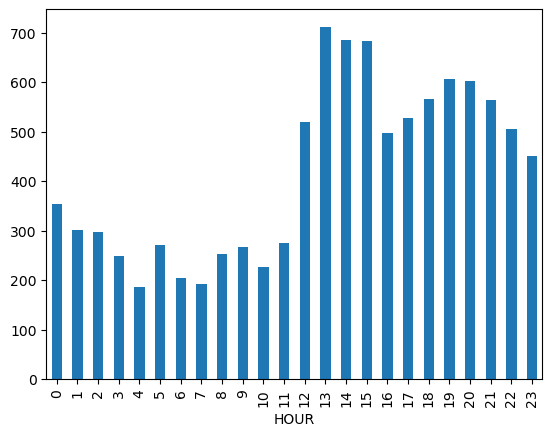

In [44]:
df.HOUR.value_counts().sort_index().plot.bar()

In [45]:
h_df_2 = df[df.HOUR == 13]

In [46]:
h_df_2.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,POLYLINE,START_LOC,END_LOC,WEEK_DAY,HOUR
500,1372664268620000517,STAND_BASED,1372664268,"[[41.145624, -8.610876], [41.145714, -8.610912...","[41.145624, -8.610876]","[41.147154, -8.622414]",Monday,13
512,1372664498620000144,STAND_BASED,1372664498,"[[41.145606, -8.610795], [41.145597, -8.610813...","[41.145606, -8.610795]","[41.147649, -8.62011]",Monday,13
535,1372664679620000186,OTHER,1372664679,"[[41.162499, -8.615457], [41.162481, -8.615412...","[41.162499, -8.615457]","[41.162382, -8.615511]",Monday,13
555,1372664210620000192,OTHER,1372664210,"[[41.164074, -8.662554], [41.164056, -8.662482...","[41.164074, -8.662554]","[41.150988, -8.632908]",Monday,13
560,1372663906620000344,STAND_BASED,1372663906,"[[41.157288, -8.628102], [41.157405, -8.628066...","[41.157288, -8.628102]","[41.185647, -8.645895]",Monday,13


In [47]:
coords = h_df_2.POLYLINE.iloc[0]

In [48]:
#Trip routes 
map_h =folium.Map(location= [41.141412, -8.618643], zoom_start=13)
for coords in h_df_2.POLYLINE:
    if coords:
        folium.PolyLine(coords, color='red', opacity=0.5, weight=2).add_to(map_h)

In [49]:
map_h